<h1><center>Laboratorio 2: OOP con Imágenes 📷</center></h1>

<center><strong>MDS7202: Laboratorio de Programación Científica para Ciencia de Datos - Primavera 2025</strong></center>

### Cuerpo Docente:

- Profesores: Diego Cortez, Gabriel Iturra
- Auxiliares: Melanie Peña, Valentina Rojas
- Ayudantes: Nicolás Cabello, Cristopher Urbina

### Equipo: **SUPER IMPORTANTE - notebooks sin nombre no serán revisados**

- Nombre de alumno 1:Sebastián Vásquez
- Nombre de alumno 2:Luis Ortega


### **Link de repositorio de GitHub:** [Repositorio](https://github.com/sivv1812/Repositorio_del_grupo_del_Reino_cienticero/tree/lab_2)

## Reglas:

- **Grupos de 2 personas**
- Fecha de entrega: Entregas Martes a las 23:59.
- Instrucciones del lab el viernes a las 16:15 en formato online. Asistencia no es obligatoria, pero se recomienda **fuertemente** asistir.
- <u>Prohibidas las copias</u>. Cualquier intento de copia será debidamente penalizado con el reglamento de la escuela.
- Tienen que subir el laboratorio a u-cursos y a su repositorio de github. Labs que no estén en u-cursos no serán revisados. Recuerden que el repositorio también tiene nota.
- Cualquier duda fuera del horario de clases al foro. Mensajes al equipo docente serán respondidos por este medio.
- Pueden usar cualquier material del curso que estimen conveniente.

### Temas a tratar:

- Programación Orientada a Objetos.
- Programación Funcional.
- `Numpy` para manejo de datos en arreglos/tensores.




### Objetivos principales del laboratorio

- Aplicar los paradigmas y buenas prácticas de programación vistas hasta este momento.
- Comprender y aprovechar las ventajas que nos ofrece la liberia `numpy` con respecto a trabajar en Python 'puro'.
- Visualizar aplicaciones de filtros de imágenes sin el uso de librerías.
- Verificar que el uso indiscriminado de `for` puede afectar en la eficiencia en al procesar datos masivos.


El laboratorio deberá ser desarrollado **sin el uso indiscriminado de iteradores nativos de python (aka "for", "while")**. La idea es que aprendan a exprimir al máximo las funciones optimizadas que nos entrega `numpy`, las cuales vale mencionar, son bastante más eficientes que los iteradores nativos sobre arreglos.

El lab estará basado en algunos conceptos básicos de procesamiento de imágenes, por lo que te iremos guiando, paso a paso por cada uno de los tópicos a desarrollar.

## Descripción del laboratorio.

En Data Science son múltiples las aplicaciones que exigen el uso exhaustivo de listas de varias dimensiones. Estas entidad reciben formalmente el nombre de **arreglos o tensores**.

Pensemos en que queremos almacenar objetos en un casillero común y corriente: podemos pensar que este puede ser representado por una matriz de dos dimensiones: alto y ancho. ¿Que sucederá si este casillero nos queda pequeño y queremos guardar más información del mismo tipo?: La solución es simple es agregar otro casillero. Esto puede ser pensado como el aumento de la dimensión de nuestro objeto, pasando a ser ahora (alto, ancho, id casillero). Esto no es otra cosa que un **tensor de 3 dimensiones**.

<br>
<center>
<img src="https://i.imgur.com/HRiF5qA.png" width=600 height=600 />
</center>
<br>

### ¿Bueno y que tiene que ver todo esto con las imágenes?

Una imagen es una representación visual de una matriz que contiene de números que describen intensidades de color (llamados píxeles). Esto visto desde la perspectiva de una imagen en blanco y negro, vendria siendo una matriz que reune las diferentes intensidades de los pixeles desde 0 a 255.

<br>
<center>
<img src="https://miro.medium.com/max/1386/1*bV7S0zACdidh11ikjYpLpQ.png" width=500 height=500 alt="Representación de una imagen" />
</center>
<br>

Cuando las imágenes poseen colores, las imágenes vendrían siendo "sin querer queriendo", una bella representación de lo que es un tensor: estas pueden ser representadas por un tensor de 3 dimensiones que les dan el *ancho, alto y el canal*, en donde son alojados los colores de la imagen.

<br>
<center>
<img src="https://miro.medium.com/max/2146/1*icINeO4H7UKe3NlU1fXqlA.jpeg" width=300 height=300 alt="Representación de una imagen" />
</center>
<br>

Como pueden ver, la imagen puede ser interpretada como un tensor de tres dimensiones(un ancho, un alto y la intensidad de cada color) en el a cada posición $(i,j)$ de la imagen, le asociaremos 3 intensidades de colores RGB (Rojo, Verde y Azul). Estas intensidades irán desde el $0$ al $255$. La combinación de estos 3 canales nos permitirá representar gran parte de los colores que encontramos en la naturaleza.

**Instalar paquetes: Si están usando conda**


In [1]:
import sys

!conda install --yes --prefix {sys.prefix} pillow plotly imageio

"conda" no se reconoce como un comando interno o externo,
programa o archivo por lotes ejecutable.


**Instalar paquetes: Si están usando pip**


In [2]:
import sys

!{sys.executable} -m pip install pillow plotly imageio

"C:\Users\Luis" no se reconoce como un comando interno o externo,
programa o archivo por lotes ejecutable.


**En caso de trabajar con colab:**

In [3]:
try:
    from google.colab import drive

    drive.mount("/content/drive")
    path = ""
except:
    print('Ignorando conexión drive-colab')

Ignorando conexión drive-colab


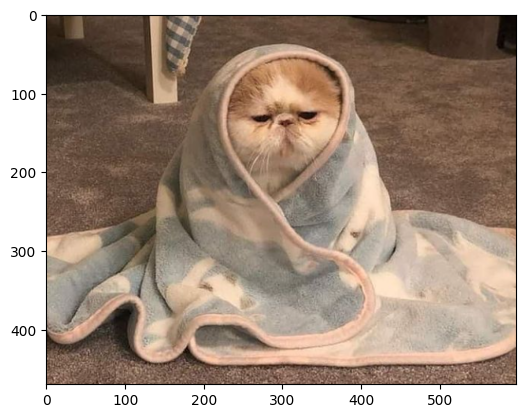

In [4]:
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt

# Esto es lo que se usa en el resto del laboratorio
foto = np.array(Image.open("./images_lab/cobija.PNG").convert("RGB")) # Red Green Blue


plt.imshow(foto)
plt.show()

Luego, llamando la variable donde alojamos el array podemos ver los valores que componen a esta imagen.

In [5]:
print(f'Número de dimensiones: {foto.ndim}')
print(f'Número de elementos por dimensión: {foto.shape}')

Número de dimensiones: 3
Número de elementos por dimensión: (470, 597, 3)


Finalmente visualizamos de forma aleatoria los pixeles de cada canal para mostrar sus intensidades.

In [6]:
print(f"Ejemplo de pixel (10, 200) en el canal 0 - Red: {foto[10, 200, 0]}")
print(f"Ejemplo de pixel (10, 200) en el canal 1- Green: {foto[10, 200, 1]}")
print(f"Ejemplo de pixel (10, 200) en el canal 2- Blue: {foto[10, 200, 2]}")

Ejemplo de pixel (10, 200) en el canal 0 - Red: 97
Ejemplo de pixel (10, 200) en el canal 1- Green: 70
Ejemplo de pixel (10, 200) en el canal 2- Blue: 48


Con lo anterior, suponiendo que la imagen del "gatito" tiene una altura igual a 600 y un ancho de 400, el tensor $G$ que representa a la imagen vendrá dado por $G[600, 400, 3]$.

### Videos

Luego, si queremos complejizar aún mas esto y queremos tener tensores que agrupen un conjunto de imágenes (de igual tamaño) tendremos lo siguiente:


<br>
<center>
<img src="https://encrypted-tbn0.gstatic.com/images?q=tbn:ANd9GcRk4BWrH_xi_blsx9Y32OTT8k80vI90udG-Yg&usqp=CAU" width=300 height=300 alt="Representación de una imagen" />
</center>
<br>

Este conjunto de imágenes nos generará la necesidad de producir una nueva dimensión, esto producto que las dimensiones son los espacios donde alojamos la información, por esto al conjunto de imágenes le agregaremos una dimensión que identifica cada una de las imágenes del conjunto, quedando representada por el tensor $G[0:n_d, 600, 400, 3]$. Por lo general, cuando tenemos imágenes con dimensionalidad 4 es porque se tratan de videos, o sea una secuencia de imágenes; el caso se complejiza aún más cuando agregamos sonido y esto se va a las pailas.

<blockquote>Dato:
La representación que posee cada una de las dimensiones puede cambiar dependiendo de la librería utilizada, en pytorch por ejemplo las dimensiones de una imagen vienen dadas por [batch, canales, alto, ancho] y no [batch, alto, ancho, canales] como en numpy.
</blockquote>


### ¿Ya, pero esto tiene aplicaciones más allá de guardar información en casilleros?

Para el caso de imágenes podemos encontrar múltiples aplicaciones con la manipulación de los tensores y operando matemáticamente con ellos. Algunas de las aplicaciones más conocidas (y que aplicaremos) son las siguientes:

- **Obtener el negativo de una imagen**: Consiste en obtener el color complementario de una imagen, para esto debemos restar la imagen con la máxima intensidad que podemos encontrar en una imagen (o sea 255).
    
    
- **Pasar a escala de grises una imagen**: Los valores RGB se convierten a escala de grises mediante la fórmula NTSC:

    $$ imagen\_gris = 0.299 * Rojo + 0.587 * Verde + 0.114 * Azul $$
    
    Esta fórmula representa la percepción relativa de la persona promedio del brillo de la luz roja, verde y azul.
    
    
- **Mejora de contraste**: Son múltiples las técnicas que nos permiten mejorar el contraste de una imagen, pero, una técnica simple para modificar los contrastes consta en obtener un factor de corrección llamado F en base al contraste deseado (C). Luego, es aplicado en la diferencia entre la imagen y 128. De esta forma obtenemos R, que es la imagen con la mejora de contraste deseada.

    $$ F=259*(C+255)/(255*(259-C)) $$
    $$ R=F*(img-128)+128 $$
  
  
- **Convolución**: Consiste en recorrer una imagen por cada uno de sus canales utilizando una matriz que lleva por nombre Kernel. El kernel, examinará los conjuntos de pixeles que recorre, aplicando una multiplicación de los valores circundantes ,y sumando todos los valores generados de este producto para generar un nuevo pixel en el tensor de salida.

![conv](https://media3.giphy.com/media/i4NjAwytgIRDW/giphy.gif "miracomorecorre")

---

# Desarrollo

En base a lo explicado y visto en clases, a continuación, deben construir cada uno de los programas solicitados en las actividades señaladas más abajo. Estás, deben ser desarrollados de forma grupal (**2 personas por grupo**) y, la solución no debe ser compartida con personas externas al grupo; si se detecta que dos grupos entregan el mismo trabajo, será considerado plagio y se tomaran medidas al respecto.

## 2. Creación de Clases y Funciones.

#### Importamos librerias utiles 😸

In [7]:
# Libreria Core del lab.
import numpy as np
from pathlib import Path

# Librerias para graficar
import matplotlib.pyplot as plt

# Nota: Utilizar solo matplot para este lab. NO USAR PLOTLY,
# ya que tiene problemas de compatibilidad con imagenes

# Funcionalidades dependientes del Sistema Operativo.
import os

# Librerias utiles para cargar y generar Gifs
import imageio
from PIL import Image
from scipy.signal import convolve2d

### 2.1. Carga de imagenes y visualización

Descomprima el archivo "images_lab.zip" en algún directorio de su computador o plataforma, observen las imágenes y clasifíquenlas a su gusto, para luego en un diccionario cargar y agrupar las diferentes imágenes (no cree mas de tres llaves).

Hecho esto, visualize dos imágenes y verifique la dimensionalidad de estas imágenes con el comando *.shape*. Comente la dimensionalidad de las imágenes.

### Carga de imagenes en diccionarios

Las siguientes celdas de código le permitirá cargar las imágenes que utilizaremos durante este laboratorio.

La primera celda implementa la función `from_jpg`, la cual, dado una ruta, carga una imágen:


In [8]:
def from_jpg(path):
    image = np.array(Image.open(path), dtype='int')
    return image

La segunda celda carga las imágenes y las guarda en un diccionario.

In [9]:
images = {
    "gatitos": [
        from_jpg("./images_lab/gato1.jpg"),
        from_jpg("./images_lab/gato2.jpg"),
        from_jpg("./images_lab/gato4.jpg"),
    ],
    "Personas": [
        from_jpg("./images_lab/personas.jpg"),
        from_jpg("./images_lab/gurus.jpg"),
    ],
    "Monos_chinos": [from_jpg("./images_lab/monitos.jpg")],
}

### Plot de imagenes
A continuación, utilice la función `def show(imagen)` (definida más abajo) para explorar las imágenes cargadas en la celda anterior.

**Respuesta Esperada**:

In [10]:
def show(imagen):
    plt.imshow(imagen)
    plt.show()
    x, y, z = imagen.shape
    print(f'Dimensiones de la imagen: {x}x{y} (Alto x Ancho)')

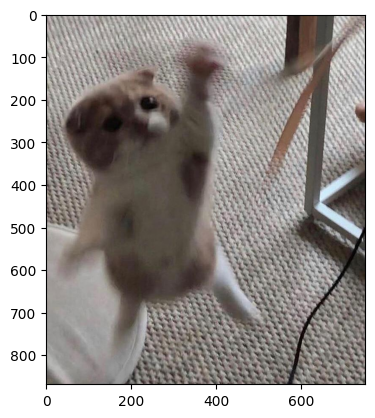

Dimensiones de la imagen: 869x750 (Alto x Ancho)


In [11]:
show(images['gatitos'][0])
# usar show para mostrar las otras imágenes...

### 2.2 Clase imagenes [2 puntos].

Ahora que sabemos cómo plotear y cargar una imagen, cree una clase llamada "Imagen" la que cumpla las siguientes características:

- [X] Un constructor que tome como argumento una imagen y que lo guarde como un atributo. `__init__` debe comprobar que la imagen es un arreglo de numpy (con `isinstance`) y adicionalmente que este tiene 3 dimensiones. En caso contrario, debe levantar excepciones con mensajes correspondientes al error detectado (ustedes definen el mensaje).
- [ ] Implemente el método `show()` que muestre la imagen usando la función `plt.show()`.
- [ ] Implemente el método `info()` que retorna un string con las dimensiones de la imagen.
- [ ] Sobrecargue el método mágico `__mul__`, `__add__` y `__sub__` para realizar operaciones matemáticas entre el objeto y arrays, int o floats. Realice la función pensando que la operación se puede aplicar tanto para izquierda y derecha. Como estamos trabajando con imágenes los outputs deben ser enteros, por esto se le aconseja utilizar `.astype(int)` para transformar los arrays de salida a un formato legible por matplotlib.
- [ ] Es importante que para las operaciones `__add__` y `__sub__` implementen una saturación de las imágenes. Es decir, la suma o resta deben dar como valor máximo 255 y/o como valor mínimos mayores o iguales a 0.
- [ ] Para el caso de `__mul__` deben implementar un método que nos permita saturar las imágenes (es decir que los valores del array no sobrepasen 255) y también no nos permita obtener valores inferiores a cero.

Implementadas los métodos, compruebe que la funcionalidad es la correcta mediante la ejecución de los asserts incluidos un par de celdas más abajo.

> **Notas:**
- Pueden reutilizar el código implementado en las celdas anteriores para implementar los métodos `show` e `info` . Sin embargo, No invoquen directamente esas funciones.
- La idea es que la imagen contenida en la clase sea inmutable, por ende, todos los metodos que modifiquen la imagen contenida en el objeto deberan retornar un nuevo objeto de la clase `Imagen` que contenga la imagen modificada.

In [12]:
class Imagen:
    """Clase contenedora de imágenes"""

    def __init__(self, img):
        if isinstance(img, np.ndarray):
            if img.ndim != 3:
                raise ( "El argumento debe ser un arreglo de numpy de solo 3 dimensiones")
            if img.shape[-1] != 3:
                raise (
                    "El argumento debe ser un arreglo de numpy de solo 3 dimensiones "
                    "tal que la última dimensión solo tiene 3 canales"
                )
            self.imagen = img
        else:
            raise TypeError(
                "Debes entregar un arreglo de numpy como argumento del constructor de "
                "Imagen"
            )

    def show(self):
        """Muestra la imágen contenida en el objeto.
        Su funcionalidad debe ser igual a la de la función mostrar_imagen.
        """
        #implementando la función show usando la libreria matplot
        #usando .imshow para pasar la imagen a un grafico de matplot
        plt.imshow(self.imagen)
        #mostrando la imagen
        plt.show()

    def info(self):
        """ Imprime las características de la imagen cargada: Alto y ancho.
        """
        x, y, z = self.imagen.shape
        #Imprimiendo el alto y el ancho de la imagen
        print(f'Caracteristicas de la imagen cargada:')
        print(f'Alto: {x}')
        print(f'Ancho: {y}')

    def __add__(self, other):
        """Redefine la operación + entre imagen y escalar.

        # Idea, usar indexado condicial (similar a los filtros de pandas).
        # Sumar y luego que en cada pixel mayor a 255 sea asignado el máximo.
        # Ver los tests para mas información.

        Parameters
        ----------
        other : Union[int, float, np.ndarray]
            Escalar o arreglo que será sumado a cada pixel de la imagen
        """
        #Aplicando la caracteristica de sumar a la clase imagen
        #se usa isintance para asegurar que other sea un int o un float
        if isinstance(other, (int, float)):
            img = self.imagen + other
        #se usa isintance para asegurar que other sea un arreglo de numpy
        elif isinstance(other, np.ndarray):
            img = self.imagen + other
        else:
            raise TypeError("Solo puedes sumar un escalar o un arreglo de numpy.")

        #Aqui se asegura de que los valores minimos y maximo de la imagen sean de 0 y 255 respectivamente
        img[img < 0] = 0
        img[img > 255] = 255
        return Imagen(img)

    def __radd__(self, other):
        """Operación conmutativa de __add__.

        Hint: debería llamar a __add__...

        Parameters
        ----------
        other : Union[int, float, np.ndarray]
            Escalar o arreglo que será sumado a cada pixel de la imagen
        """
        #como la suma es una función conmutativa, simplemente se llama a __add__
        return self.__add__(other)

    def __sub__(self, other):
        """Redefine la operación + entre imagen y escalar.

        # Idea, usar indexado condicial (similar a los filtros de pandas).
        # Restar y luego que en cada pixel mayor a 255 sea asignado el máximo.
        # Caso similar para valores menores a 0, donde debera asignar el minimo a esos pixeles
        # Ver los tests para mas información.

        Parameters
        ----------
        other : Union[int, float, np.ndarray]
            Escalar o arreglo que será sumado a cada pixel de la imagen
        """
        #Aplicando la resta a la clase imagen
        #se usa isintance para asegurar que other sea un int o un float
        if isinstance(other, (int, float)):
            img = self.imagen - other
        #se usa isintance para asegurar que other sea un arreglo de numpy
        elif isinstance(other, np.ndarray):
            img = self.imagen - other
        else:
            #Lanza error cuando other no es un escarlar o un arreglo de numpy
            raise TypeError("Solo puedes sumar un escalar o un arreglo de numpy.")

        #Aqui se asegura de que los valores minimos y maximo de la imagen sean de 0 y 255 respectivamente
        img[img < 0] = 0
        img[img > 255] = 255
        return Imagen(img)

    def __rsub__(self, other):
        """Operación conmutativa de __sub__.

        Parameters
        ----------
        other : Union[int, float, np.ndarray]
            Escalar o arreglo que será sumado a cada pixel de la imagen
        """
        #Aplicando a la clase imagen una resta, no se llama a __sub__ debido a que la resta no es conmutativa.
        #se usa isintance para asegurar que other sea un int o un float
        if isinstance(other, (int, float)):
            img =  other - self.imagen
        #se usa isintance para asegurar que other sea un arreglo de numpy
        elif isinstance(other, np.ndarray):
            img =  other - self.imagen
        else:
            #Lanza error cuando other no es un escarlar o un arreglo de numpy
            raise TypeError("Solo puedes sumar un escalar o un arreglo de numpy.")

        #Aqui se asegura de que los valores minimos y maximo de la imagen sean de 0 y 255 respectivamente
        img[img < 0] = 0
        img[img > 255] = 255
        return Imagen(img)


    def __mul__(self, other):
        """Redefine la operación + entre imagen y escalar.

        # Idea, usar indexado condicial (similar a los filtros de pandas).
        # Sumar y luego que en cada pixel mayor a 255 sea asignado el máximo y
        # cada valor inferior a 0 debe ser 0.
        # Ver los tests para mas información.

        Parameters
        ----------
        other : Union[int, float, np.ndarray]
            Escalar o arreglo que será sumado a cada pixel de la imagen
        """
        #Aplicando la multiplicación a la clase imagen
        #se usa isintance para asegurar que other sea un int o un float
        if isinstance(other, (int, float)):
            img =  other * self.imagen
        #se usa isintance para asegurar que other sea un arreglo de numpy
        elif isinstance(other, np.ndarray):
            img =  other * self.imagen
        else:
            #Lanza error cuando other no es un escarlar o un arreglo de numpy
            raise TypeError("Solo puedes sumar un escalar o un arreglo de numpy.")

        #Aqui se asegura de que los valores minimos y maximo de la imagen sean de 0 y 255 respectivamente
        img[img < 0] = 0
        img[img > 255] = 255
        return Imagen(img)


    def __rmul__(self, other):
        """Operación conmutativa de __mul__.

        Hint: debería llamar a __mul__...

        Parameters
        ----------
        other : Union[int, float, np.ndarray]
            Escalar o arreglo que será sumado a cada pixel de la imagen
        """
        #como la multiplicación es conmutativa, simplemente se llama a __mul__
        return self.__mul__(other)


**Resultados esperados:**

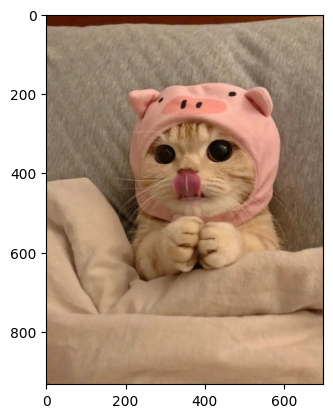

In [13]:
gatito = Imagen(images["gatitos"][1])
gurus = Imagen(images["Personas"][1])
gatito.show()

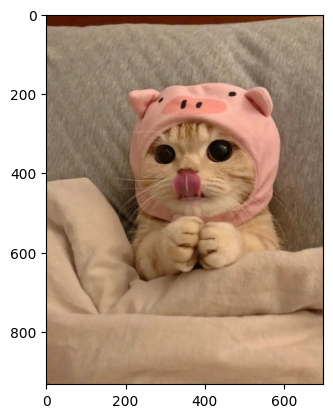

Caracteristicas de la imagen cargada:
Alto: 933
Ancho: 700


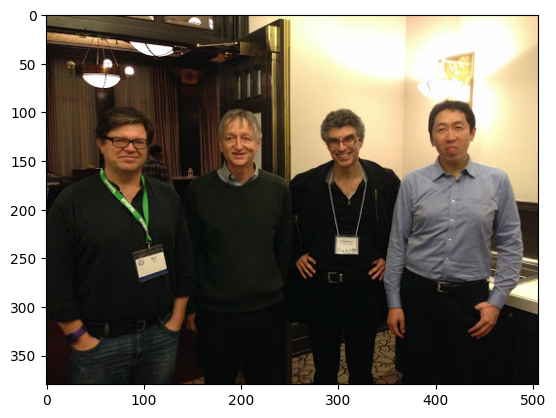

Caracteristicas de la imagen cargada:
Alto: 380
Ancho: 506


In [14]:
# Test show e info.
gatito.show()
gatito.info()

gurus.show()
gurus.info()

In [15]:
# Tests de los overload de operadores.

# Test __add__
# Idea del test: Todos los elementos de la imagen deben ser a lo más 255.

# Test __add__
assert np.max((gatito + 1000).imagen) == 255

# Test __radd__
assert np.max((1000 + gatito).imagen) == 255

# Test __sub__
assert np.min((gatito - (-1000)).imagen) == 255

# Test __sub__
assert np.max((gatito - 1000).imagen) == 0

# Test __rsub__
assert np.min((1000 - gatito ).imagen) == 255

# Test __mul__ (probar minimo)
assert np.max((-555555 * gatito).imagen) == 0

# Test __mul__ (probar maximo)
assert np.max((555555*gatito).imagen) == 255

# Test __rmul__ (probar minimo)
assert np.max((gatito*-555555).imagen) == 0

# Test __rmul__ (probar maximo)
assert np.max((gatito*555555).imagen) == 255



### 2.3 Clase de Procesamiento de Imagenes [2 puntos]

Ahora que comprenden las diferentes dimensiones que componen a una imagen (en la práctica), ahora realizaremos diferentes tareas de procesamiento de imágenes. Para esto, deben crear una clase llamada "`LibImagen`" que cumpla los siguientes requisitos:

- [ ] Pasar una imagen a escala de grises, para esto utilice la ecuación (1) expuesta en este mismo notebook.
- [ ] Obtener los canales R, G y B de forma individual.
- [ ] Crear una función que pase a negativo de la imagen alojada.
- [ ] Mejorar el contraste de una imagen.
- [ ] Realizar una convolución sobre la imagen.
- [ ] Documentar la clase creada y verificar la documentación con el comando help().


> **Nota 🗒️**: Todo método debe tomar una Imagen y retornar una nueva Imagen.

> **Nota 2**: El tipo de datos del arreglo de la imagen que generen o modifiquen debe ser "int". De lo contrario, puede no visualizarse correctamente.


In [16]:
class LibImagen():

    def to_negative(self, img_in):
        """Convierte imagen a negativo.

        Parameters
        ----------
        img_in : Imagen
            Objeto Imagen que contiene imagen a procesar.

        Returns
        -------
        Imagen
            Objeto Imagen con la imagen procesada.
        """
        # Buscando colores complementario restando los valores de la imagen con 255
        return 255 - img_in


    def to_gray(self, img_in):
        """
        Transforma una imagen en RGB a la escala de grises.

        Parameters
        ----------
        img_in : Imagen
            Objeto Imagen que contiene una imagen.

        Returns
        -------
        Imagen
            Una que contiene una imagen con 3 canales.
            Los 3 canales deben tener los mismos valores.
        """
        #Separando los tres canales de la imagen
        rojo=img_in.imagen[:,:,0]
        verde=img_in.imagen[:,:,1]
        azul=img_in.imagen[:,:,2]

        #aplicando la formula que pasa a escalas de grises
        gris=rojo*0.299+verde*0.587+azul*0.114
        #asegurando que los arreglos de la imagen sean int
        gris = gris.astype(int)
        #generando un arreglo numpy con lo generado en la formula
        img=np.stack((gris, gris, gris), axis=-1)
        #retornando una imagen con el arreglo imp
        return Imagen(img)


    def get_channel(self, img_in, channel):
        """Obtiene un canal de un color seteando el resto de los canales en 0.

        Parameters
        ----------
        img_in : Imagen
            Objeto Imagen que contiene una imagen.
        channel : str
            Nombre del canal que será seleccionado. Valores posibles: ('r','g' o 'b').

        Returns
        -------
        Imagen:
            Objeto Imagen que contiene una imagen con 3 canales.
            Solo el canal seleccionado debe tener valores distintos a 0.
        """
        #Separando los tres canales de la imagen
        rojo=img_in.imagen[:,:,0]
        verde=img_in.imagen[:,:,1]
        azul=img_in.imagen[:,:,2]

        #generando un arreglo imp con los canales de la imagen
        img=np.stack((rojo,verde,azul), axis=-1)
        #creando una imagen con el arreglo anterior
        img=Imagen(img)

        #verificando que el canal seleccionado sea rojo
        if channel=="r":
            #pasando los valores del canal verde a 0
            img.imagen[:,:,1]=0
            #pasando los valores del canal azul a 0
            img.imagen[:,:,2]=0
        #verificando que el canal seleccionado sea verde
        elif channel=="g":
            #pasando los valores del canal rojo a 0
            img.imagen[:,:,0]=0
            #pasando los valores del canal azul a 0
            img.imagen[:,:,2]=0
        #verificando que el canal seleccionado sea azul
        elif channel=="b":
            ##pasando los valores del canal rojo a 0
            img.imagen[:,:,0]=0
            #pasando los valores del canal verde a 0
            img.imagen[:,:,1]=0
        else:
            #Lanza error cuando other no es un escarlar o un arreglo de numpy
            raise TypeError("Solo puedes usar r, g o b en el atributo channel.")
        #retornando la imagen con el canal seleccionado
        return img


    def set_contrast(self, img_in, C):
        """Mejora el contraste de una imagen.

        Parameters
        ----------
        img_in : Imagen
            Objeto Imagen que contiene una imagen.
        C : float
            Parámetro que define el ajuste de contraste.

        Returns
        -------
        Imagen
            Objeto Imagen que contiene una imagen con 3 canales modificados.
        """
        #obteniendo el arreglo de la imagen
        img=img_in.imagen

        #creando factor de correción
        F = 259 * (C + 255) / (255 * (259 - C))
        #aplicando factor de correción
        R = F * (img - 128) + 128
        #asegurando que los valores de R sean int
        R=R.astype(int)
        #Aqui se asegura de que los valores minimos y maximo de la imagen sean de 0 y 255 respectivamente
        img[img < 0] = 0
        img[img > 255] = 255
        return Imagen(R)


    def conv_channel(self, img_in, kernel):
        """Por documentar (esto es parte del puntaje)...
        """
        #obteniendo el arreglo de la imagen
        img = img_in.imagen
        #creando una lista para guardar los valores
        img_out = []
        #recorriendo los canales i  de la imagen
        for i in range(img.shape[-1]):
            #se aplica el kernel a convolución de la imagen en el canal i
            img_channel = convolve2d(img[:, :, i],
                                     kernel,
                                     mode="same",
                                     boundary="symm")
            #agregando los valores a la lista
            img_out.append(img_channel)
        #generando arreglo numpy con los valores de la lista
        new_image = np.stack(img_out, axis=2)
        #se asegura que los valores de la imagen este entre 0 y 255
        new_image[new_image>255], new_image[new_image<0] = 255, 0
        #retorna la imagen generada asegurando que la imagen contengan valores enteros
        return Imagen(new_image.astype(int))

### 2.4 Probar [0,5 puntos]

**Respuesta Esperada**:

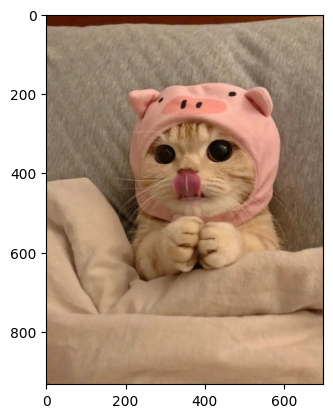

Negativo


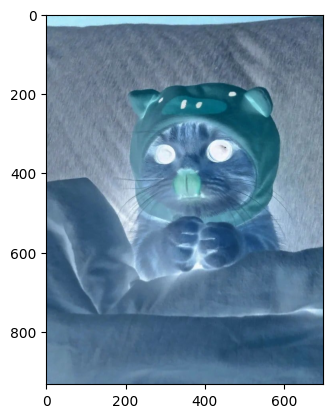

Grayscale


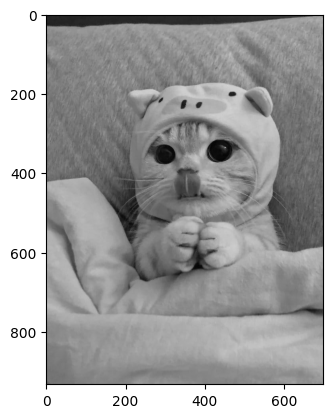

Selección de Canales


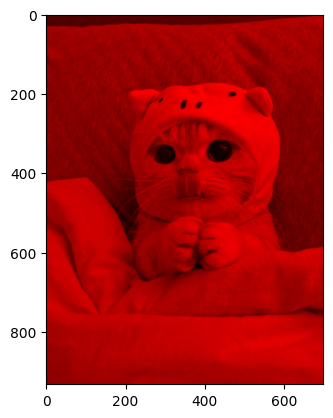

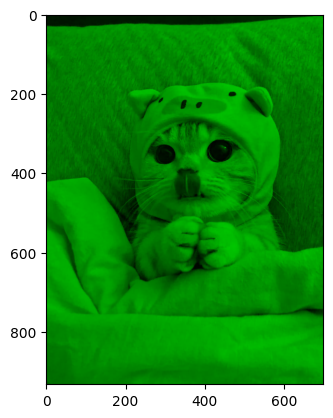

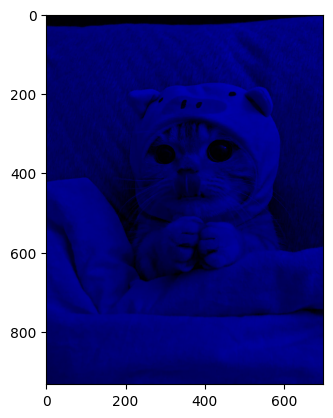

Mejora de Contraste


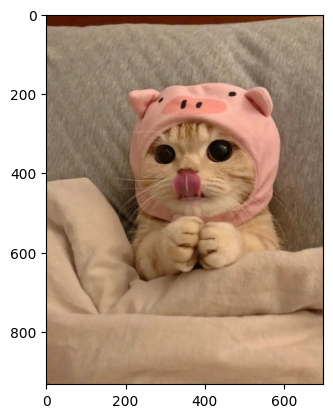

Convolución


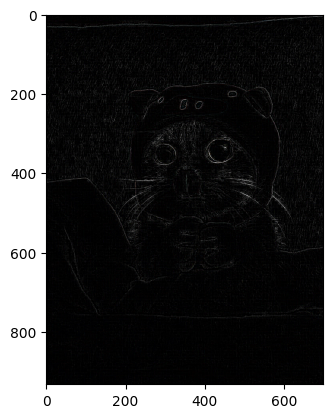

In [17]:
gatito = Imagen(images["gatitos"][1])

gatito.show()

lib = LibImagen()

print('Negativo')
lib.to_negative(gatito).show()

print('Grayscale')
lib.to_gray(gatito).show()

print('Selección de Canales')
lib.get_channel(gatito, "r").show()
lib.get_channel(gatito, "g").show()
lib.get_channel(gatito, "b").show()

print('Mejora de Contraste')
lib.set_contrast(gatito, 0).show()

print('Convolución')
kernel = np.array([[-1, -1,  -1],
                   [-1,  8,  -1],
                   [-1, -1,  -1]])

lib.conv_channel(gatito, kernel).show()

#### Implementar 5 Kernels y probarlos con las imagenes

Referencia:
https://en.wikipedia.org/wiki/Kernel_(image_processing)

In [18]:
# Convolución
# 1. Kernel para enfocar la imagen (Sharpen)
kernel_sharpen = np.array([
    [0, -1, 0],
    [-1, 5, -1],
    [0, -1, 0]
])

# 2. Kernel para detectar todos los bordes (Edge Detection)
kernel_edge = np.array([
    [-1, -1, -1],
    [-1, 8, -1],
    [-1, -1, -1]
])

# 3. Kernel para desenfocar la imagen (Blur)
kernel_blur = np.array([
    [1/16, 2/16, 1/16],
    [2/16, 4/16, 2/16],
    [1/16, 2/16, 1/16]
])

# 4. Kernel de relieve (Emboss)
kernel_emboss = np.array([
    [-2, -1, 0],
    [-1,  1, 1],
    [ 0,  1, 2]
])

# 5. Kernel de detección de bordes horizontales (Sobel Horizontal)
kernel_sobel_horizontal = np.array([
    [ 1,  2,  1],
    [ 0,  0,  0],
    [-1, -2, -1]
])




1. Efecto: Enfocar (Sharpen)


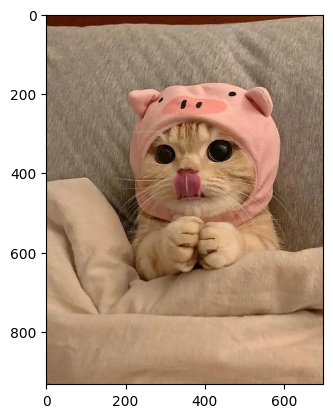


2. Efecto: Detección de Bordes (Edge)


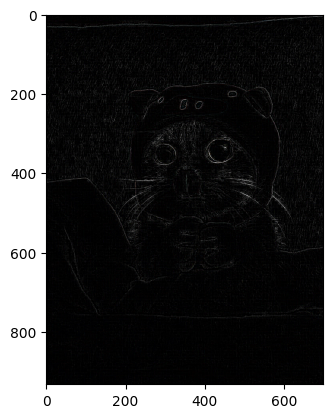


3. Efecto: Desenfoque (Blur)


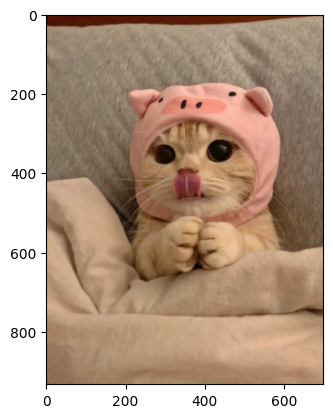


4. Efecto: Relieve (Emboss)


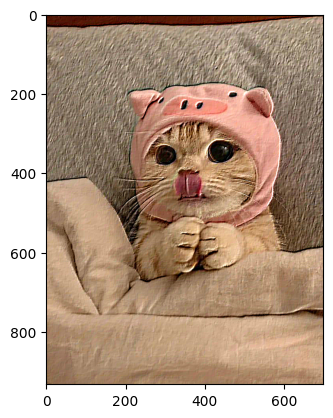


5. Efecto: Bordes Horizontales (Sobel)


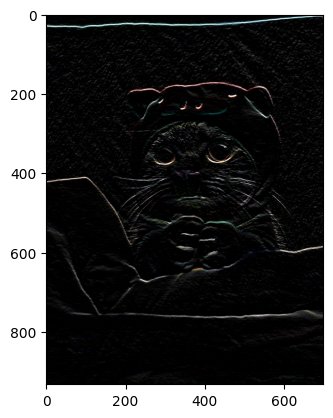

In [19]:

# 1. Filtro de Enfoque (Sharpen)
print('\n1. Efecto: Enfocar (Sharpen)')
lib.conv_channel(gatito, kernel_sharpen).show()

# 2. Filtro de Detección de Bordes (Edge)
print('\n2. Efecto: Detección de Bordes (Edge)')
lib.conv_channel(gatito, kernel_edge).show()

# 3. Filtro de Desenfoque (Blur)
print('\n3. Efecto: Desenfoque (Blur)')
lib.conv_channel(gatito, kernel_blur).show()

# 4. Filtro de Relieve (Emboss)
print('\n4. Efecto: Relieve (Emboss)')
lib.conv_channel(gatito, kernel_emboss).show()

# 5. Filtro de Bordes Horizontales (Sobel)
print('\n5. Efecto: Bordes Horizontales (Sobel)')
lib.conv_channel(gatito, kernel_sobel_horizontal).show()

**Comente:**

Al aplicar los distintos kernels a la imagen del gatito observamos los siguientes efectos:

1. Filtro de Enfoque (Sharpen): Este filtro aumenta la nitidez de la imagen. Lo logra al realzar el contraste entre los píxeles vecinos. El centro del kernel tiene un valor alto (5) que se resta con los valores negativos que lo rodean, lo que hace que los bordes y detalles finos, como el pelaje del gato, se vean mucho más definidos y claros.

2. Filtro de Detección de Bordes (Edge): Su función es resaltar los contornos de los objetos en la imagen. El kernel está diseñado para que las áreas con color uniforme se vuelvan negras (valor 0), mientras que las zonas con un cambio brusco de color (los bordes) se vuelvan blancas. Esto se logra porque la suma de los productos es alta en los bordes y cercana a cero en las áreas planas.

3. Filtro de Desenfoque (Blur): Este filtro suaviza la imagen, reduciendo el detalle y el ruido. Cada píxel se reemplaza por un promedio ponderado de sus píxeles vecinos. Esto hace que las transiciones de color sean menos bruscas, resultando en una imagen más borrosa y con menos detalles perceptibles.

4. Filtro de Relieve (Emboss): Este kernel crea un efecto tridimensional, como si la imagen estuviera tallada o en relieve. Lo consigue al desplazar la imagen y restarla de la original, lo que ilumina los bordes en una dirección y los oscurece en la dirección opuesta, simulando una fuente de luz y creando una percepción de profundidad.

5. Filtro de Bordes Horizontales (Sobel): Es un tipo de detector de bordes más específico que identifica principalmente las líneas y contornos horizontales. Los valores positivos en la fila superior y negativos en la inferior hacen que el filtro reaccione fuertemente a los cambios verticales de color, que es lo que define un borde horizontal. Por eso, en la imagen resultante, las líneas horizontales del fondo son las que más se destacan.



## 3. Secuencias y Detección de Movimiento


### 3.2. Secuencia de Imagenes [1,5 punto]


A continuación, deben programar una función que nos permite resaltar los objetos en movimientos de una secuencia de imágenes. Para esta parte del laboratorio, deberá utilizar las imágenes dispuestas en la carpeta `secuencia_plaza` del archivo zip subido a material docente.

Primero que todo, cargue la secuencia de imágenes que se encuentran en el directorio. Para esto, se recomienda utilizar el comando `os.listdir(dir)`, ya que este le facilitará la carga de un gran número de imágenes (pruebe el comando y vea que sucede).

In [20]:
import os
from PIL import Image
import numpy as np

#path = "/content/drive/My Drive/Trabajos/Laboratorio MDS/Lab2/secuencia_plaza/"
#img_names = sorted(os.listdir(path))

#imagenes = np.array([np.array(Image.open(path + img)) for img in img_names])

path = "./secuencia_plaza/"
img_names = os.listdir(path)

imagenes = np.array(list(map(lambda img: np.array(Image.open(path + img)), img_names)))



![plaza se mueve](https://media0.giphy.com/media/ZAzlopoHETs5lZQ6EZ/giphy.gif "plaza")

Para realizar este ejercicio utilizaremos un método super básico para la eliminación de fondo. Para esto sigue la siguiente receta:
 1. Pase a escala de grises todas las imágenes secuenciales.
 2. Almacene en una variable la resta de las imágenes consecutivas.

   $$ imagen\_out = imagen(t) - imagen(t+1) $$

 3. Establezca un umbral para eliminar algunos artefactos. Pruebe con al menos 3 umbrales.

$$ imagen\_out = imagen\_out> Umbral $$

**Nota**: No es necesario que construya una clase para esta parte.

Esta función detecta el movimiento en una secuencia de imágenes.
Para evitar los problemas de memoria RAM que tuvimos, decidimos procesar las imágenes de a pares en vez de cargar toda la secuencia a la vez.

In [21]:
import imageio
import numpy as np

def dect_mov(secuencia_de_imagenes, umbral=30):

    # Paso 1: Convierto la lista de imágenes a un único y gran arreglo de numpy.
    # Así puedo aplicar operaciones a todas las imágenes a la vez.
    # También las paso a escala de grises en el mismo paso.
    lib = LibImagen()
    secuencia_gris = np.array([lib.to_gray(Imagen(img)).imagen for img in secuencia_de_imagenes])

    # Paso 2: Uso np.diff() para calcular la diferencia entre imágenes consecutivas.
    # Esta función está super optimizada y hace exactamente lo que antes hacía
    # mi 'for', pero de una sola vez y mucho más rápido.
    # El 'axis=0' le dice que compare cada imagen (en el eje 0) con la siguiente.
    diferencias = np.abs(np.diff(secuencia_gris, axis=0))

    # Paso 3: Aplico el umbral a todas las diferencias de una sola vez.
    # Esto me da un arreglo de True/False.
    hubo_movimiento = diferencias > umbral

    # Paso 4: Convierto el resultado a un formato de imagen visible.
    # El movimiento (True) se vuelve blanco (255) y el fondo (False) negro (0).
    # Lo hago para los 3 canales de color para que sea un GIF estándar.
    frames_finales = np.stack([hubo_movimiento[:,:,:,0]] * 3, axis=-1).astype(np.uint8) * 255

    # Devuelvo una lista de frames, que es lo que imageio necesita para crear el GIF.
    return list(frames_finales)

# --- Bloque para generar y guardar los 3 GIFs ---
print("Generando GIFs con diferentes umbrales (versión 100% Numpy)...")

# Prueba 1: Umbral bajo
gif_frames_20 = dect_mov(imagenes, umbral=20)
imageio.mimsave('plaza_20.gif', gif_frames_20, fps=10)
print("¡GIF 'plaza_20.gif' creado!")

# Prueba 2: Umbral medio
gif_frames_50 = dect_mov(imagenes, umbral=50)
imageio.mimsave('plaza_50.gif', gif_frames_50, fps=10)
print("¡GIF 'plaza_50.gif' creado!")

# Prueba 3: Umbral alto
gif_frames_100 = dect_mov(imagenes, umbral=100)
imageio.mimsave('plaza_100.gif', gif_frames_100, fps=10)
print("¡GIF 'plaza_100.gif' creado!")

print("\n¡Proceso finalizado!")

Generando GIFs con diferentes umbrales (versión 100% Numpy)...
¡GIF 'plaza_20.gif' creado!
¡GIF 'plaza_50.gif' creado!
¡GIF 'plaza_100.gif' creado!

¡Proceso finalizado!


### 3.3 Resultado

Ahora es tiempo de relajarse y ver si nuestro experimento logra resaltar los objetos en movimiento de esta polémica Plaza, para esto solo ejecute el siguiente Código y espere.

A continuación, se presentan los GIFs generados con tres umbrales distintos para observar cómo varía la sensibilidad en la detección de movimiento.

### 1. Resultado con Umbral = 20 (Alta Sensibilidad)
Con un umbral bajo, el detector es muy sensible y captura no solo el movimiento de las personas, sino también cambios sutiles de luz y "ruido" en la imagen.

![Umbral 20](plaza_20.gif)

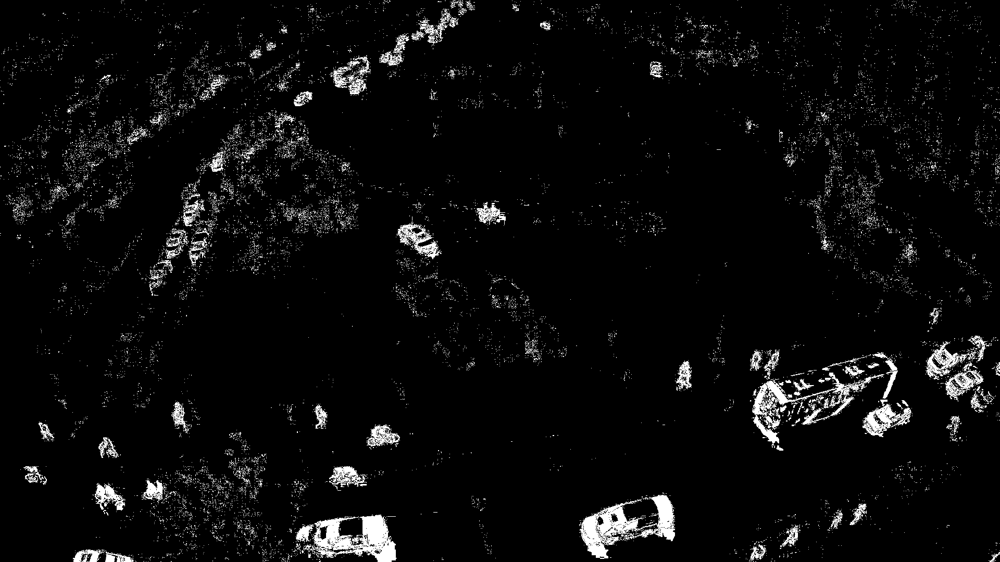

In [22]:
from IPython.display import Image, display
display(Image(filename="plaza_20.gif"))

### 2. Resultado con Umbral = 50 (Sensibilidad Media)
Este umbral ofrece un buen equilibrio. Logra eliminar la mayor parte del ruido de fondo, enfocándose en los movimientos más claros y definidos de las personas que caminan por la plaza.

![Umbral 50](plaza_50.gif)

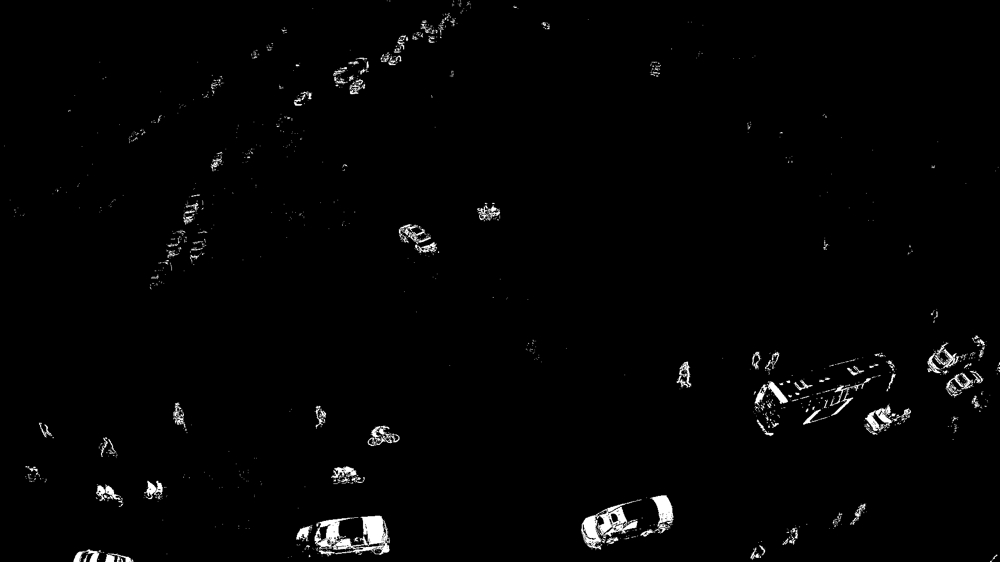

In [23]:
display(Image(filename="plaza_50.gif"))

### 3. Resultado con Umbral = 100 (Baja Sensibilidad)
Con un umbral alto, el detector es mucho menos sensible. Solo se marcan los movimientos más bruscos y evidentes, perdiendo algunos de los desplazamientos más sutiles.

![Umbral 100](plaza_100.gif)


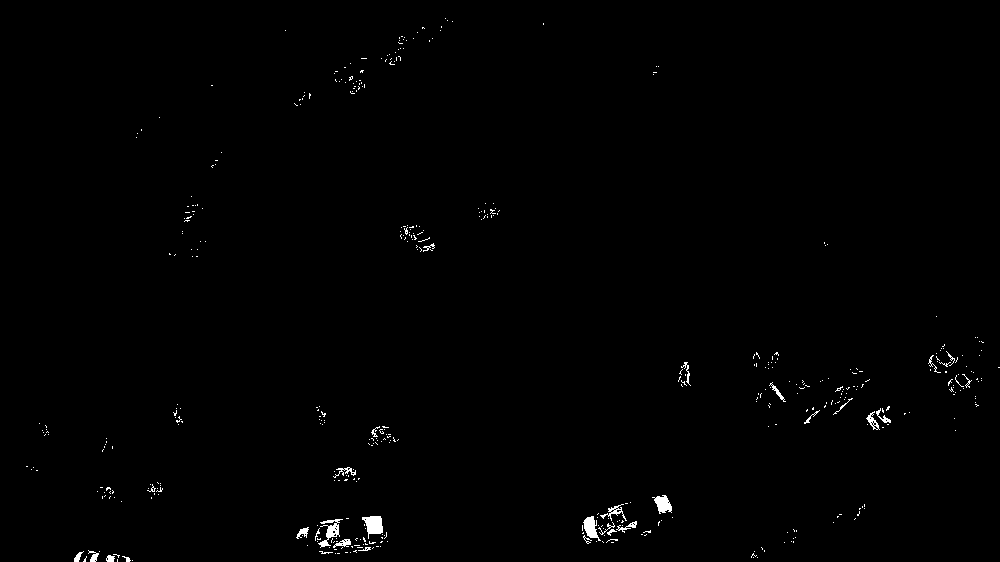

In [24]:
display(Image(filename="plaza_100.gif"))

**Ejemplo de resultado esperado:**

![resultados](https://media3.giphy.com/media/SKV3bgUzHt0MLJTWW2/giphy.gif "res")

### Referencias lab 1.

- http://www.cs.cornell.edu/cv/SummerSchool/Introduction.pdf
- https://en.wikipedia.org/wiki/Tensor
- https://support.ptc.com/help/mathcad/es/index.html#page/PTC_Mathcad_Help/example_grayscale_and_color_in_images.html
- http://w3.unpocodetodo.info/canvas/negativo.php
- http://www.dfstudios.co.uk/articles/programming/image-programming-algorithms/image-processing-algorithms-part-5-contrast-adjustment/